In [4]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
%cd ..

/Users/purzelrakete/src/github.com/purzelrakete/hi/jpeg


In [10]:
import numpy as np
import matplotlib.pyplot as plt
import IPython.display as ipd
from PIL import Image

import jpeg

# Exploring JPEG compression

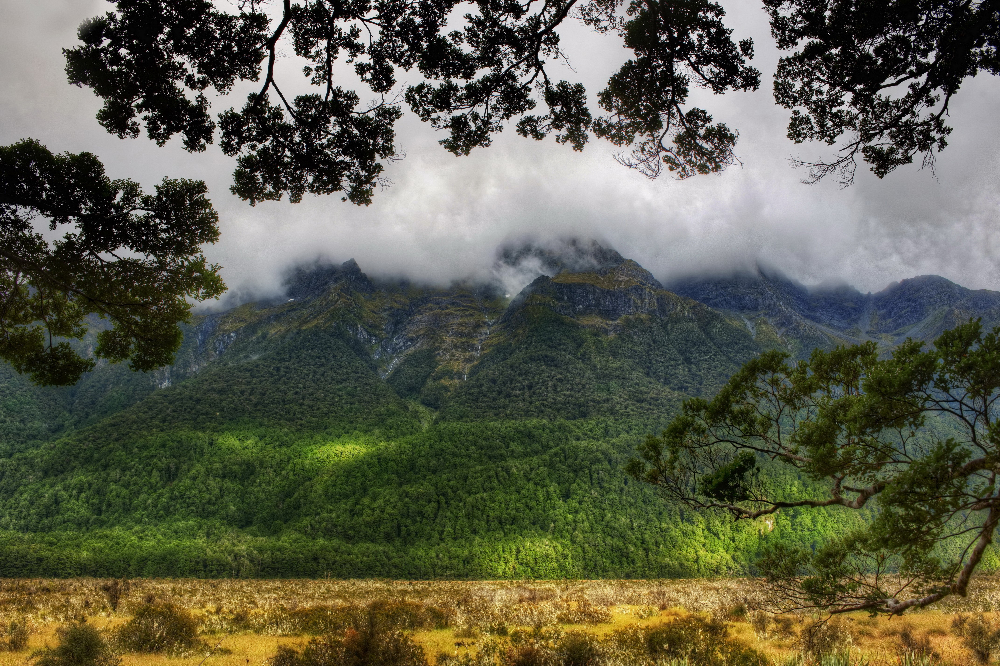

In [125]:
img = Image.open('media/forest.jpg')
img

In [126]:
img_data = np.asarray(img)
dims = img_data.shape
dims

(2860, 4289, 3)

Compression is based on the following observations:

- The human eye is more sensitive to brightness differences than it is to color differences
- The human eye is not sensitive to high frequency content in images

## Removing color information

We will remove some color without touching the perceived brightness. We will do this by converting to the [YCbCr](https://en.wikipedia.org/wiki/YCbCr) color space, where $Y$ is the luminosity component and $C_B$ and $C_R$ are the blue-difference and red-difference chroma components.

In [131]:
def ycbcr_component(img, component):
    ycbcr = np.asarray(img.convert('YCbCr'))
    for i in [0, 1, 2]:
        if i != component:
            ycbcr[:, :, i] = 16
    return Image.fromarray(ycbcr, 'YCbCr').convert('RGB')

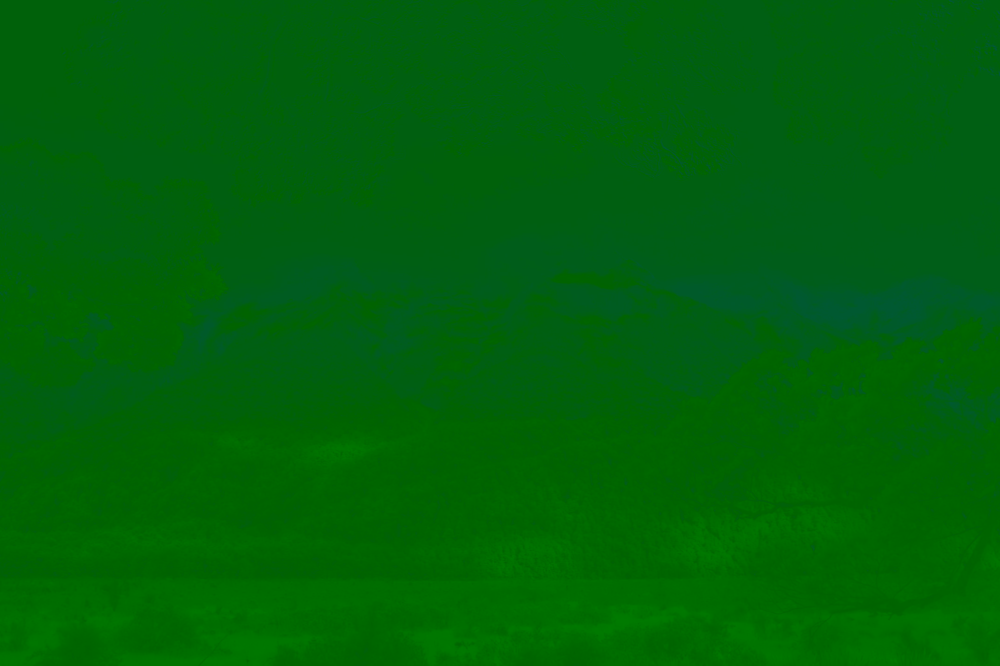

In [133]:
ycbcr_component(img, 1)

Luminance:

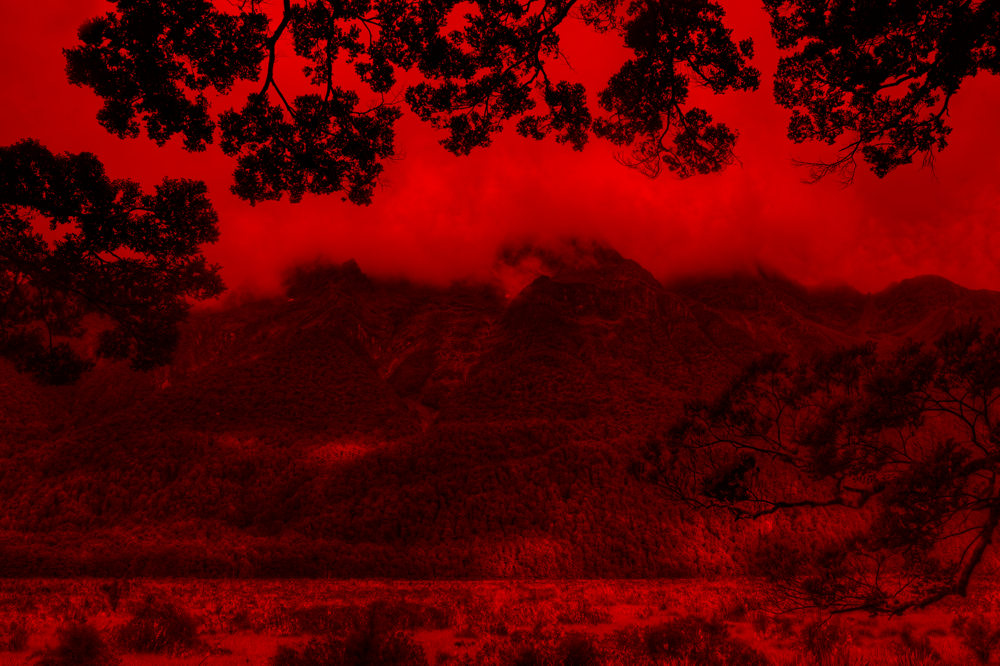

In [103]:
ycbcr[:, :, 1] = 0.
ycbcr[:, :, 2] = 0.
Image.fromarray(ycbcr)

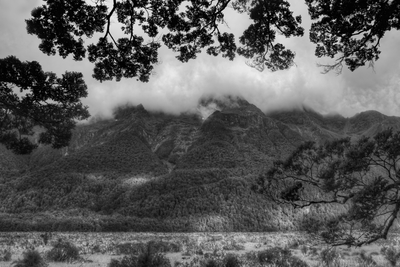

In [79]:
luminance = Image.fromarray(ycbcr[:, :, 0])
luminance.thumbnail((400, 400), Image.ANTIALIAS)
luminance

Blue difference:

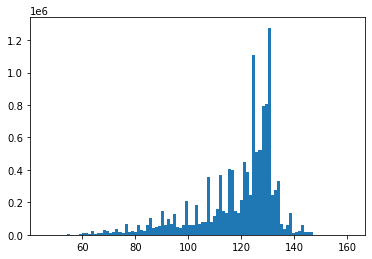

In [96]:
blue_diff = Image.fromarray(ycbcr[:, :, 1])
# blue_difference.thumbnail((400, 400), Image.ANTIALIAS)
# blue_difference.convert('RED')
plt.hist(ycbcr[:, :, 1].flatten(), bins=100);

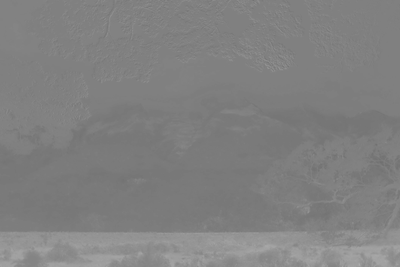

In [82]:
red_difference = Image.fromarray(ycbcr[:, :, 2])
red_difference.thumbnail((400, 400), Image.ANTIALIAS)
red_difference